# L1 and L2 Regularization for UCI Credit Approval Data Set





## 01) Downloading Dataset

In [ ]:
!pip install wget
import wget
wget.download('https://archive.ics.uci.edu/ml/machine-learning-databases/credit-screening/crx.data')

  Created wheel for wget: filename=wget-3.2-cp37-none-any.whl size=9675 sha256=2f35f4d2e56e367995cd73c1bb9ef4003c91f98f4c242d11f0d0fd63e0ad71ff
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget


'crx.data'

## 02) Import and Evaluate Dataset

In [ ]:
import pandas as pd
import numpy as np
!pip install dataprep
import dataprep

     |████████████████████████████████| 1.8MB 3.8MB/s 
     |████████████████████████████████| 71kB 7.6MB/s 
     |████████████████████████████████| 727kB 31.3MB/s 
     |████████████████████████████████| 81kB 7.3MB/s 
     |████████████████████████████████| 368kB 33.4MB/s 
     |████████████████████████████████| 1.5MB 34.0MB/s 
     |████████████████████████████████| 1.3MB 44.1MB/s 
     |████████████████████████████████| 10.1MB 11.3MB/s 
     |████████████████████████████████| 849kB 31.3MB/s 
     |████████████████████████████████| 51kB 5.9MB/s 
     |████████████████████████████████| 747kB 32.0MB/s 
     |████████████████████████████████| 296kB 39.2MB/s 
     |████████████████████████████████| 143kB 43.0MB/s 
     |████████████████████████████████| 51kB 6.7MB/s 
     |████████████████████████████████| 112kB 54.5MB/s 
  Created wheel for metaphone: filename=Metaphone-0.6-cp37-none-any.whl size=13918 sha256=47dc4c1f0e066c6dfbd118595de588c695da14146a70485e102ecab8b45736ba
  Stored in d

In [ ]:
dataset =  pd.read_csv('crx.data', sep=",", header=None, na_values='?')
dataset.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,b,30.83,0.000,u,g,w,v,1.25,t,t,1,f,g,202.0,0,+
1,a,58.67,4.460,u,g,q,h,3.04,t,t,6,f,g,43.0,560,+
2,a,24.50,0.500,u,g,q,h,1.50,t,f,0,f,g,280.0,824,+
3,b,27.83,1.540,u,g,w,v,3.75,t,t,5,t,g,100.0,3,+
4,b,20.17,5.625,u,g,w,v,1.71,t,f,0,f,s,120.0,0,+


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 690 entries, 0 to 689
Data columns (total 16 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       678 non-null    object 
 1   1       678 non-null    float64
 2   2       690 non-null    float64
 3   3       684 non-null    object 
 4   4       684 non-null    object 
 5   5       681 non-null    object 
 6   6       681 non-null    object 
 7   7       690 non-null    float64
 8   8       690 non-null    object 
 9   9       690 non-null    object 
 10  10      690 non-null    int64  
 11  11      690 non-null    object 
 12  12      690 non-null    object 
 13  13      677 non-null    float64
 14  14      690 non-null    int64  
 15  15      690 non-null    object 
dtypes: float64(4), int64(2), object(10)
memory usage: 86.4+ KB


NumExpr defaulting to 2 threads.


DataPrep Report
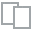
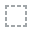
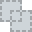
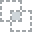
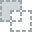
...
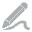
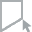
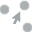
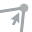
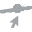

In [ ]:
from dataprep.eda import create_report
create_report(dataset)

## 03) Pre-processing Dataset

### 03-01) Drop Rows with Missing Values

In [ ]:
dataset.dropna(inplace=True)

In [ ]:
dataset.info()
print(dataset.apply(lambda col: [[col.min(), col.max(), col.unique()]]).transpose())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 653 entries, 0 to 689
Data columns (total 16 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       653 non-null    object 
 1   1       653 non-null    float64
 2   2       653 non-null    float64
 3   3       653 non-null    object 
 4   4       653 non-null    object 
 5   5       653 non-null    object 
 6   6       653 non-null    object 
 7   7       653 non-null    float64
 8   8       653 non-null    object 
 9   9       653 non-null    object 
 10  10      653 non-null    int64  
 11  11      653 non-null    object 
 12  12      653 non-null    object 
 13  13      653 non-null    float64
 14  14      653 non-null    int64  
 15  15      653 non-null    object 
dtypes: float64(4), int64(2), object(10)
memory usage: 86.7+ KB
                                                    0
0                                      [a, b, [b, a]]
1   [13.75, 76.75, [30.83, 58.67, 24.5, 27.83, 20....
2  

### 03-02) Encode Categorical Variables

In [ ]:
categorical_variables = [0,3,4,5,6,8,9,11,12,15]
numerical_variables = [1,2,7,10,13,14]

In [ ]:
# encode class values as integers 
from sklearn.preprocessing import LabelEncoder
for col in categorical_variables:
  encoder = LabelEncoder()
  encoder.fit(dataset[col])
  dataset[col]= encoder.transform(dataset[col])


In [ ]:
dataset.head(5)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,1,30.83,0.000,1,0,12,7,1.25,1,1,1,0,0,202.0,0,0
1,0,58.67,4.460,1,0,10,3,3.04,1,1,6,0,0,43.0,560,0
2,0,24.50,0.500,1,0,10,3,1.50,1,0,0,0,0,280.0,824,0
3,1,27.83,1.540,1,0,12,7,3.75,1,1,5,1,0,100.0,3,0
4,1,20.17,5.625,1,0,12,7,1.71,1,0,0,0,2,120.0,0,0


In [ ]:
dataset.info()
print(dataset.apply(lambda col: [[col.min(), col.max(), col.unique()]]).transpose())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 653 entries, 0 to 689
Data columns (total 16 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       653 non-null    int64  
 1   1       653 non-null    float64
 2   2       653 non-null    float64
 3   3       653 non-null    int64  
 4   4       653 non-null    int64  
 5   5       653 non-null    int64  
 6   6       653 non-null    int64  
 7   7       653 non-null    float64
 8   8       653 non-null    int64  
 9   9       653 non-null    int64  
 10  10      653 non-null    int64  
 11  11      653 non-null    int64  
 12  12      653 non-null    int64  
 13  13      653 non-null    float64
 14  14      653 non-null    int64  
 15  15      653 non-null    int64  
dtypes: float64(4), int64(12)
memory usage: 86.7 KB
                                                    0
0                                      [0, 1, [1, 0]]
1   [13.75, 76.75, [30.83, 58.67, 24.5, 27.83, 20....
2   [0.0, 28.0,

### 03-03) Splitting the Dataset to X and y

In [ ]:
X = dataset.drop(columns=15)
y = dataset[15]

In [ ]:
X.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,1,30.83,0.000,1,0,12,7,1.25,1,1,1,0,0,202.0,0
1,0,58.67,4.460,1,0,10,3,3.04,1,1,6,0,0,43.0,560
2,0,24.50,0.500,1,0,10,3,1.50,1,0,0,0,0,280.0,824
3,1,27.83,1.540,1,0,12,7,3.75,1,1,5,1,0,100.0,3
4,1,20.17,5.625,1,0,12,7,1.71,1,0,0,0,2,120.0,0


## 04) NN Training

### 04-01) Explorating with random manualy entered Values

In [ ]:
import tensorflow as tf
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score, RepeatedKFold
from sklearn.metrics import f1_score, accuracy_score
from sklearn.preprocessing import StandardScaler
results = pd.DataFrame(columns =['Layers', 'units', 'optimizer', 'loss', 'metrics', 'activation','f1_score'])

In [ ]:
def create_model(input_dim, num_layers, num_units, optimizer, loss, metrics, activation):
  ann = tf.keras.models.Sequential()
  ann.add(tf.keras.layers.Dense(units=num_units[0], input_dim=input_dim, kernel_initializer='he_uniform', activation='relu'))
  for i in range(1, num_layers-1):
    ann.add(tf.keras.layers.Dense(units=num_units[i], activation=activation[0]))
  ann.add(tf.keras.layers.Dense(units=num_units[-1], activation=activation[1]))
  ann.compile(optimizer = optimizer, loss = loss, metrics = metrics)

  return ann

In [ ]:
def evaluate_model(X, y, num_layers, num_units, optimizer, loss, metrics, epochs, batch_size, activation, results):
  X_in = X.copy()
  y_in = y.copy()
  f1_scores = []

  ann = create_model(X_in.shape[1], num_layers, num_units, optimizer, loss, metrics, activation)
  
  X_in = np.asarray(X_in).astype(np.float32)
  y_in = np.asarray(y_in).astype(np.float32)

  cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1)

  for train_ix, test_ix in cv.split(X_in):
    X_train, X_test = X_in[train_ix], X_in[test_ix]
    y_train, y_test = y_in[train_ix], y_in[test_ix]
    #Feature Scaling the Training Data
    sc = StandardScaler()
    X_train[numerical_variables] = sc.fit_transform(X_train[numerical_variables])
    X_test[numerical_variables] = sc.transform(X_test[numerical_variables])

    ann.fit(X_train, y_train, verbose=0, epochs=epochs)
    
    yhat = ann.predict(X_test)
    yhat = yhat.round()
    
    f1 = f1_score(y_test, yhat)
    f1_scores.append(f1)
  row = {'Layers':num_layers,
         'units':str(num_units),
         'optimizer':optimizer,
         'loss':loss,
         'metrics':str(metrics),
         'activation':str(activation),
         'f1_score':sum(f1_scores)/len(f1_scores)}
  print("Average F1 Score for NN with No of Layers: %2d, Units: %s, optimizer: %s, loss: %s, metrics: %s = %2.3f" %(num_layers, str(num_units), optimizer, loss, str(metrics), sum(f1_scores)/len(f1_scores)))
  return results.append(row, ignore_index=True)
  

In [ ]:
results = evaluate_model(X, y, 3, [512, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  3, Units: [512, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.780
Average F1 Score for NN with No of Layers:  3, Units: [256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.689
Average F1 Score for NN with No of Layers:  3, Units: [32, 32, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.828
Average F1 Score for NN with No of Layers:  4, Units: [512, 256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.774
Average F1 Score for NN with No of Layers:  4, Units: [256, 256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.807
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.826
Average F1 Score for NN with No of Layers:  5, Units: [512, 256, 256, 128, 1], optimizer: adam, loss: binary_crossentropy, metrics: 

In [ ]:
results = evaluate_model(X, y, 3, [512, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  3, Units: [512, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.724
Average F1 Score for NN with No of Layers:  3, Units: [256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.000
Average F1 Score for NN with No of Layers:  3, Units: [32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.794
Average F1 Score for NN with No of Layers:  4, Units: [512, 256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.000
Average F1 Score for NN with No of Layers:  4, Units: [256, 256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.000
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.760
Average F1 Score for NN with No of Layers:  5, Units: [512, 256, 256, 128, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accur

In [ ]:
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)


Average F1 Score for NN with No of Layers:  3, Units: [256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.142
[0.711340206185567, 0.0, 0.0, 0.0, 0.0]
Average F1 Score for NN with No of Layers:  3, Units: [32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.750
[0.7244897959183674, 0.7486033519553071, 0.7356321839080459, 0.759776536312849, 0.7812499999999999]
Average F1 Score for NN with No of Layers:  4, Units: [512, 256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.297
[0.758169934640523, 0.7261146496815286, 0.0, 0.0, 0.0]
Average F1 Score for NN with No of Layers:  4, Units: [256, 256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.000
[0.0, 0.0, 0.0, 0.0, 0.0]
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.755
[0.7999999999999999, 0.7552447552447551, 0.7241379310344828

In [ ]:
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)


Average F1 Score for NN with No of Layers:  5, Units: [256, 256, 256, 256, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.710


In [ ]:
results = evaluate_model(X, y, 3, [512, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','softmax'], results)

results = evaluate_model(X, y, 3, [512, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)


results = evaluate_model(X, y, 3, [512, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 3, [256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 3, [32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 4, [512, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 4, [256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 5, [512, 256, 256, 128, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 5, [256, 256, 256, 256, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32, ['relu','softmax'], results)

Average F1 Score for NN with No of Layers:  3, Units: [512, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  3, Units: [256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  3, Units: [32, 32, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  4, Units: [512, 256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  4, Units: [256, 256, 256, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  5, Units: [512, 256, 256, 128, 1], optimizer: adam, loss: binary_crossentropy, metrics: 

In [ ]:
results = evaluate_model(X, y, 3, [72, 42, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  3, Units: [72, 42, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.732


In [ ]:
results = evaluate_model(X, y, 2, [25, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 2, [15, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)
results = evaluate_model(X, y, 2, [30, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  2, Units: [25, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.786
Average F1 Score for NN with No of Layers:  2, Units: [15, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.731
Average F1 Score for NN with No of Layers:  2, Units: [30, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.778


In [ ]:
results = evaluate_model(X, y, 2, [128, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  2, Units: [128, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.803


In [ ]:
results = evaluate_model(X, y, 3, [128, 64, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  3, Units: [128, 64, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.000


In [ ]:
results = evaluate_model(X, y, 3, [30, 15, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  3, Units: [30, 15, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.808


In [ ]:
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 4, [32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32,  ['relu','softmax'], results)

results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['tanh','sigmoid'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32, ['tanh','softmax'], results)
results = evaluate_model(X, y, 5, [32, 32, 32, 32, 1], 'adam',  'mean_squared_error', ['accuracy'], 100, 32,  ['relu','softmax'], results)

Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.785
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  5, Units: [32, 32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.789
Average F1 Score for NN with No of Layers:  5, Units: [32, 32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.707
Average F1 Score for NN with No of Layers:  5, Units: [32, 32, 32, 32, 1], optimizer: adam, loss: mean_squared_error, metrics: ['accuracy'] = 0.707


In [ ]:
results = evaluate_model(X, y, 4, [176, 240, 240, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  4, Units: [176, 240, 240, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.807


In [ ]:
results = evaluate_model(X, y, 4, [32, 32, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  4, Units: [32, 32, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.843


In [ ]:
results = evaluate_model(X, y, 4, [25, 25, 25, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [23, 23, 23, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [28, 28, 28, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  4, Units: [25, 25, 25, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.848
Average F1 Score for NN with No of Layers:  4, Units: [23, 23, 23, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.794
Average F1 Score for NN with No of Layers:  4, Units: [28, 28, 28, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.817


In [ ]:
results = evaluate_model(X, y, 4, [18, 18, 18, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [20, 20, 20, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  4, Units: [18, 18, 18, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.828
Average F1 Score for NN with No of Layers:  4, Units: [20, 20, 20, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.848
Average F1 Score for NN with No of Layers:  4, Units: [16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.827


In [ ]:
results = evaluate_model(X, y, 4, [21, 21, 21, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [22, 22, 22, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)
results = evaluate_model(X, y, 4, [23, 23, 23, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  4, Units: [21, 21, 21, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.796
Average F1 Score for NN with No of Layers:  4, Units: [22, 22, 22, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.828
Average F1 Score for NN with No of Layers:  4, Units: [23, 23, 23, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.824


In [ ]:
results = evaluate_model(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.850


In [ ]:
results = evaluate_model(X, y, 2, [512, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], results)

Average F1 Score for NN with No of Layers:  2, Units: [1024, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.774


In [ ]:
results.head(100)

,Layers,units,optimizer,loss,metrics,activation,f1_score
0,3,"[512, 256, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.779677
1,3,"[256, 256, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.688833
2,3,"[32, 32, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.827622
3,4,"[512, 256, 256, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.774289
4,4,"[256, 256, 256, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.807121
...,...,...,...,...,...,...,...
65,4,"[16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.826982
66,4,"[21, 21, 21, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.796269
67,4,"[22, 22, 22, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.827835
68,4,"[23, 23, 23, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",0.823598


In [ ]:
results.to_csv('Results_without_reg.csv')

### 04-02) NN Param Tuning

In [ ]:
!pip install keras-tuner
import kerastuner as kt
from tensorflow import keras

     |████████████████████████████████| 71kB 2.8MB/s 
  Created wheel for keras-tuner: filename=keras_tuner-1.0.2-cp37-none-any.whl size=78935 sha256=a961edbd91fa602b8d61231a218381fc6581357647264cde4092eb6326c05aba
  Stored in directory: /root/.cache/pip/wheels/bb/a1/8a/7c3de0efb3707a1701b36ebbfdbc4e67aedf6d4943a1f463d6
  Created wheel for terminaltables: filename=terminaltables-3.1.0-cp37-none-any.whl size=15356 sha256=d470d34f54d664b8ed62e5bd97d2eb4cab397da4734d0fa9b23a7a7e2ace284c
  Stored in directory: /root/.cache/pip/wheels/30/6b/50/6c75775b681fb36cdfac7f19799888ef9d8813aff9e379663e
Successfully built keras-tuner terminaltables


In [ ]:
def model_builder(hp):
  model = keras.Sequential()
  

  # Tune the number of units in the first Dense layer
  # Choose an optimal value between 32-512
  hp_units1 = hp.Int('units_1', min_value=16, max_value=32, step=4)
  hp_units2 = hp.Int('units_2', min_value=16, max_value=32, step=4)
  hp_units3 = hp.Int('units_3', min_value=16, max_value=32, step=4)
  hp_units4 = hp.Int('units_4', min_value=16, max_value=32, step=4)
  
  model.add(keras.layers.Dense(units=hp_units1, activation='relu'))
  model.add(keras.layers.Dense(units=hp_units2, activation='relu'))
  model.add(keras.layers.Dense(units=hp_units3, activation='relu'))
  model.add(keras.layers.Dense(units=hp_units4, activation='relu'))

  model.add(keras.layers.Dense(units=1, activation='sigmoid'))

  # Tune the learning rate for the optimizer
  # Choose an optimal value from 0.01, 0.001, or 0.0001
  hp_learning_rate = hp.Choice('learning_rate', values=[1e-3, 1e-2])

  model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                loss='binary_crossentropy',
                metrics=['accuracy'])

  return model

In [ ]:
tuner = kt.BayesianOptimization(model_builder,
                     objective='val_accuracy',
                     directory='my_dir',
                     project_name='intro_to_kt295',
                     max_trials=400,
                     num_initial_points=50)

In [ ]:
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

In [ ]:
tuner.search(X, y, epochs=50, validation_split=0.2, callbacks=[stop_early])

Oracle triggered exit


Trial 400 Complete [00h 00m 01s]
val_accuracy: 0.732824444770813

Best val_accuracy So Far: 0.8778625726699829
Total elapsed time: 00h 48m 55s


In [ ]:
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

In [ ]:
print(best_hps.get('units_1'))
print(best_hps.get('units_2'))
print(best_hps.get('units_3'))
print(best_hps.get('units_4'))
print(best_hps.get('learning_rate'))


16
20
16
32
0.01


## 05) Regularization

### 05-01) L1 Regularization

In [ ]:
import tensorflow as tf
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score, RepeatedKFold
from sklearn.metrics import f1_score, accuracy_score
from keras.regularizers import l1
import statistics
from sklearn.model_selection import train_test_split
results_reg_val = pd.DataFrame(columns =['Layers', 'units', 'optimizer', 'loss', 'metrics', 'activation','lambda', 'f1_scores', 'f1_score_avg', 'f1_score_std'])
results_reg = pd.DataFrame(columns =['Layers', 'units', 'optimizer', 'loss', 'metrics', 'activation','lambda', 'f1_scores', 'f1_score_avg', 'f1_score_std'])

In [ ]:
def create_model_reg(input_dim, num_layers, num_units, optimizer, loss, metrics, activation, lambda_):
  ann = tf.keras.models.Sequential()
  ann.add(tf.keras.layers.Dense(units=num_units[0], input_dim=input_dim, kernel_initializer='he_uniform', kernel_regularizer=l1(lambda_), activation='relu'))
  for i in range(1, num_layers-1):
    ann.add(tf.keras.layers.Dense(units=num_units[i], activation=activation[0], kernel_regularizer=l1(lambda_)))
  ann.add(tf.keras.layers.Dense(units=num_units[-1], kernel_regularizer=l1(lambda_), activation=activation[1]))
  ann.compile(optimizer = optimizer, loss = loss, metrics = metrics)

  return ann

In [ ]:
def evaluate_model_reg_val(X, y, num_layers, num_units, optimizer, loss, metrics, epochs, batch_size, activation, lambda_, results):
  X_in = X.copy()
  y_in = y.copy()
  f1_scores = []

  ann = create_model_reg(X_in.shape[1], num_layers, num_units, optimizer, loss, metrics, activation, lambda_)
  
  X_in = np.asarray(X_in).astype(np.float32)
  y_in = np.asarray(y_in).astype(np.float32)

  cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1)

  for train_ix, test_ix in cv.split(X_in):
    X_train, X_test = X_in[train_ix], X_in[test_ix]
    y_train, y_test = y_in[train_ix], y_in[test_ix]
    #Re-splitting the training set for Validating the best lambda
    X_train_val, X_test_val, y_train_val, y_test_val = train_test_split(X_train, y_train, test_size = 0.2, random_state = 1)

    sc = StandardScaler()
    X_train_val[numerical_variables] = sc.fit_transform(X_train_val[numerical_variables])
    X_test_val[numerical_variables] = sc.transform(X_test_val[numerical_variables])
    
    ann.fit(X_train_val, y_train_val, verbose=0, epochs=epochs)
    
    yhat_val = ann.predict(X_test_val)
    yhat_val = yhat_val.round()
    
    f1 = f1_score(y_test_val, yhat_val)
    f1_scores.append(f1)
   
  row = {'Layers':num_layers,
         'units':str(num_units),
         'optimizer':optimizer,
         'loss':loss,
         'metrics':str(metrics),
         'activation':str(activation),
         'lambda':lambda_,
         'f1_scores': str(f1_scores), 
         'f1_score_avg':sum(f1_scores)/len(f1_scores),
         'f1_score_std':statistics.stdev(f1_scores)}
  print("Average F1 Score for NN with No of Layers: %2d, Units: %s, optimizer: %s, loss: %s, metrics: %s = %2.3f" %(num_layers, str(num_units), optimizer, loss, str(metrics), sum(f1_scores)/len(f1_scores)))
  return results.append(row, ignore_index=True)

In [ ]:
def evaluate_model_reg(X, y, num_layers, num_units, optimizer, loss, metrics, epochs, batch_size, activation, lambda_, results):
  X_in = X.copy()
  y_in = y.copy()
  f1_scores = []

  ann = create_model_reg(X_in.shape[1], num_layers, num_units, optimizer, loss, metrics, activation, lambda_)
  
  X_in = np.asarray(X_in).astype(np.float32)
  y_in = np.asarray(y_in).astype(np.float32)

  cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1)

  for train_ix, test_ix in cv.split(X_in):
    X_train, X_test = X_in[train_ix], X_in[test_ix]
    y_train, y_test = y_in[train_ix], y_in[test_ix]
    
    sc = StandardScaler()
    X_train[numerical_variables] = sc.fit_transform(X_train[numerical_variables])
    X_test[numerical_variables] = sc.transform(X_test[numerical_variables])

    ann.fit(X_train, y_train, verbose=0, epochs=epochs)
    
    yhat = ann.predict(X_test)
    yhat = yhat.round()
    
    f1 = f1_score(y_test, yhat)
    f1_scores.append(f1)
   
  row = {'Layers':num_layers,
         'units':str(num_units),
         'optimizer':optimizer,
         'loss':loss,
         'metrics':str(metrics),
         'activation':str(activation),
         'lambda':lambda_,
         'f1_scores': str(f1_scores),
         'f1_score_avg':sum(f1_scores)/len(f1_scores),
         'f1_score_std':statistics.stdev(f1_scores)}
  print("Average F1 Score for NN with No of Layers: %2d, Units: %s, optimizer: %s, loss: %s, metrics: %s, lambda: %2.4f = %2.3f" %(num_layers, str(num_units), optimizer, loss, str(metrics),lambda_, sum(f1_scores)/len(f1_scores)))
  return results.append(row, ignore_index=True)
  

#### 05-01-01) Validation with Train data for all 5 folds
Average on all 5 folds of f1 values from train data validation will be returned here

In [ ]:
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1.0, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.1, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.01, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.001, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.0001, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-5, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-6, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-7, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-8, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-9, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-10, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-11, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-12, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-13, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-14, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-15, results_reg_val)

Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.738
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.780
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.757
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.811
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.815
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.791
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_c

In [ ]:
results_reg_val.head(100)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  if sys.path[0] == '':


<function matplotlib.pyplot.show>

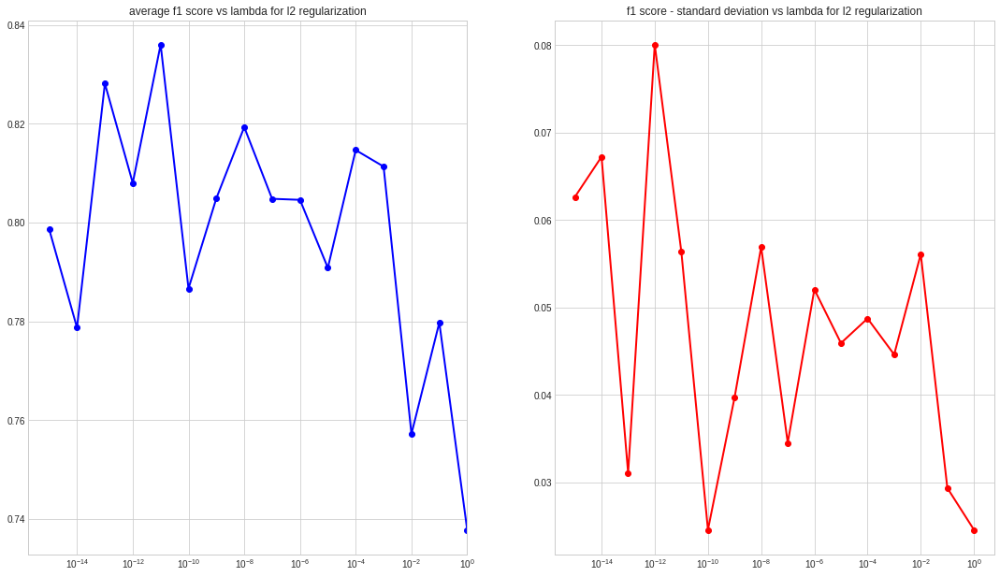

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
fig = plt.figure()
fig.set_size_inches(18.5, 10.5, forward=True)
ax = fig.add_subplot(1, 2, 1)
ax.set_title('average f1 score vs lambda for l2 regularization')
ax2 = fig.add_subplot(1, 2, 2)
ax2.set_title('f1 score - standard deviation vs lambda for l2 regularization')
line, = ax.plot(results_reg_val['lambda'], results_reg_val['f1_score_avg'], color='blue', lw=2, marker='o')
line, = ax2.plot(results_reg_val['lambda'], results_reg_val['f1_score_std'], color='red', lw=2, marker='o')
ax.set_xscale('log')
ax.set_xlim(0, 1)
ax2.set_xscale('log')
plt.show


#### 05-01-02) Evaluating the for the best lambda

In [ ]:
results_reg = evaluate_model_reg(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-11, results_reg)

Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'], lambda: 0.0000 = 0.834


In [ ]:
results_reg_val.to_csv('L1_Regularised.csv')

### 05-02) L2 Regularization

In [ ]:
import tensorflow as tf
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score, RepeatedKFold
from sklearn.metrics import f1_score, accuracy_score
from keras.regularizers import l2
import statistics
from sklearn.model_selection import train_test_split
results_reg_val = pd.DataFrame(columns =['Layers', 'units', 'optimizer', 'loss', 'metrics', 'activation','lambda', 'f1_scores', 'f1_score_avg', 'f1_score_std'])
results_reg = pd.DataFrame(columns =['Layers', 'units', 'optimizer', 'loss', 'metrics', 'activation','lambda', 'f1_scores', 'f1_score_avg', 'f1_score_std'])

In [ ]:
def create_model_reg(input_dim, num_layers, num_units, optimizer, loss, metrics, activation, lambda_):
  ann = tf.keras.models.Sequential()
  ann.add(tf.keras.layers.Dense(units=num_units[0], input_dim=input_dim, kernel_initializer='he_uniform', kernel_regularizer=l2(lambda_), activation='relu'))
  for i in range(1, num_layers-1):
    ann.add(tf.keras.layers.Dense(units=num_units[i], activation=activation[0], kernel_regularizer=l2(lambda_)))
  ann.add(tf.keras.layers.Dense(units=num_units[-1], kernel_regularizer=l2(lambda_), activation=activation[1]))
  ann.compile(optimizer = optimizer, loss = loss, metrics = metrics)

  return ann

In [ ]:
def evaluate_model_reg_val(X, y, num_layers, num_units, optimizer, loss, metrics, epochs, batch_size, activation, lambda_, results):
  X_in = X.copy()
  y_in = y.copy()
  f1_scores = []

  ann = create_model_reg(X_in.shape[1], num_layers, num_units, optimizer, loss, metrics, activation, lambda_)
  
  X_in = np.asarray(X_in).astype(np.float32)
  y_in = np.asarray(y_in).astype(np.float32)

  cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1)

  for train_ix, test_ix in cv.split(X_in):
    X_train, X_test = X_in[train_ix], X_in[test_ix]
    y_train, y_test = y_in[train_ix], y_in[test_ix]
    #Re-splitting the training set for Validating the best lambda
    X_train_val, X_test_val, y_train_val, y_test_val = train_test_split(X_train, y_train, test_size = 0.2, random_state = 1)

    sc = StandardScaler()
    X_train_val[numerical_variables] = sc.fit_transform(X_train_val[numerical_variables])
    X_test_val[numerical_variables] = sc.transform(X_test_val[numerical_variables])

    ann.fit(X_train_val, y_train_val, verbose=0, epochs=epochs)
    
    yhat_val = ann.predict(X_test_val)
    yhat_val = yhat_val.round()
    
    f1 = f1_score(y_test_val, yhat_val)
    f1_scores.append(f1)
   
  row = {'Layers':num_layers,
         'units':str(num_units),
         'optimizer':optimizer,
         'loss':loss,
         'metrics':str(metrics),
         'activation':str(activation),
         'lambda':lambda_,
         'f1_scores': str(f1_scores), 
         'f1_score_avg':sum(f1_scores)/len(f1_scores),
         'f1_score_std':statistics.stdev(f1_scores)}
  print("Average F1 Score for NN with No of Layers: %2d, Units: %s, optimizer: %s, loss: %s, metrics: %s = %2.3f" %(num_layers, str(num_units), optimizer, loss, str(metrics), sum(f1_scores)/len(f1_scores)))
  return results.append(row, ignore_index=True)

In [ ]:
def evaluate_model_reg(X, y, num_layers, num_units, optimizer, loss, metrics, epochs, batch_size, activation, lambda_, results):
  X_in = X.copy()
  y_in = y.copy()
  f1_scores = []

  ann = create_model_reg(X_in.shape[1], num_layers, num_units, optimizer, loss, metrics, activation, lambda_)
  
  X_in = np.asarray(X_in).astype(np.float32)
  y_in = np.asarray(y_in).astype(np.float32)

  cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1)

  for train_ix, test_ix in cv.split(X_in):
    X_train, X_test = X_in[train_ix], X_in[test_ix]
    y_train, y_test = y_in[train_ix], y_in[test_ix]

    sc = StandardScaler()
    X_train[numerical_variables] = sc.fit_transform(X_train[numerical_variables])
    X_test[numerical_variables] = sc.transform(X_test[numerical_variables])

    ann.fit(X_train, y_train, verbose=0, epochs=epochs)
    
    yhat = ann.predict(X_test)
    yhat = yhat.round()
    
    f1 = f1_score(y_test, yhat)
    f1_scores.append(f1)
   
  row = {'Layers':num_layers,
         'units':str(num_units),
         'optimizer':optimizer,
         'loss':loss,
         'metrics':str(metrics),
         'activation':str(activation),
         'lambda':lambda_,
         'f1_scores': str(f1_scores),
         'f1_score_avg':sum(f1_scores)/len(f1_scores),
         'f1_score_std':statistics.stdev(f1_scores)}
  print("Average F1 Score for NN with No of Layers: %2d, Units: %s, optimizer: %s, loss: %s, metrics: %s, lambda: %2.4f = %2.3f" %(num_layers, str(num_units), optimizer, loss, str(metrics),lambda_, sum(f1_scores)/len(f1_scores)))
  return results.append(row, ignore_index=True)
  

#### 05-02-01) Validation with Train data for all 5 folds
Average on all 5 folds of f1 values from train data validation will be returned here

In [ ]:
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1.0, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.1, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.01, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.001, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 0.0001, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-5, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-6, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-7, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-8, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-9, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-10, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-11, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-12, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-13, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-14, results_reg_val)
results_reg_val = evaluate_model_reg_val(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-15, results_reg_val)

Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.742
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.759
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.779
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.808
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.808
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'] = 0.826
Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_c

In [ ]:
results_reg_val.head(20)

,Layers,units,optimizer,loss,metrics,activation,lambda,f1_scores,f1_score_avg,f1_score_std
0,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e+00,"[0.7552447552447552, 0.7284768211920529, 0.734...",0.742128,0.016886
1,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-01,"[0.7313432835820896, 0.7445255474452555, 0.769...",0.758537,0.042729
2,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-02,"[0.746031746031746, 0.7659574468085106, 0.8253...",0.779197,0.041443
3,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-03,"[0.7812499999999999, 0.7741935483870968, 0.857...",0.808432,0.042549
4,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-04,"[0.7321428571428573, 0.7894736842105263, 0.831...",0.808187,0.050910
5,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-05,"[0.7666666666666666, 0.8403361344537815, 0.850...",0.826444,0.035063
6,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-06,"[0.7555555555555556, 0.7652173913043477, 0.857...",0.805877,0.048927
7,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-07,"[0.7464788732394366, 0.8281249999999999, 0.878...",0.823249,0.050871
8,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-08,"[0.8095238095238095, 0.7704918032786885, 0.859...",0.810637,0.032060
9,5,"[16, 16, 16, 16, 1]",adam,binary_crossentropy,['accuracy'],"['relu', 'sigmoid']",1.000000e-09,"[0.7428571428571429, 0.7941176470588235, 0.835...",0.815769,0.048875


In [ ]:
results_reg_val.to_csv('l2_regularization.csv')

<function matplotlib.pyplot.show>

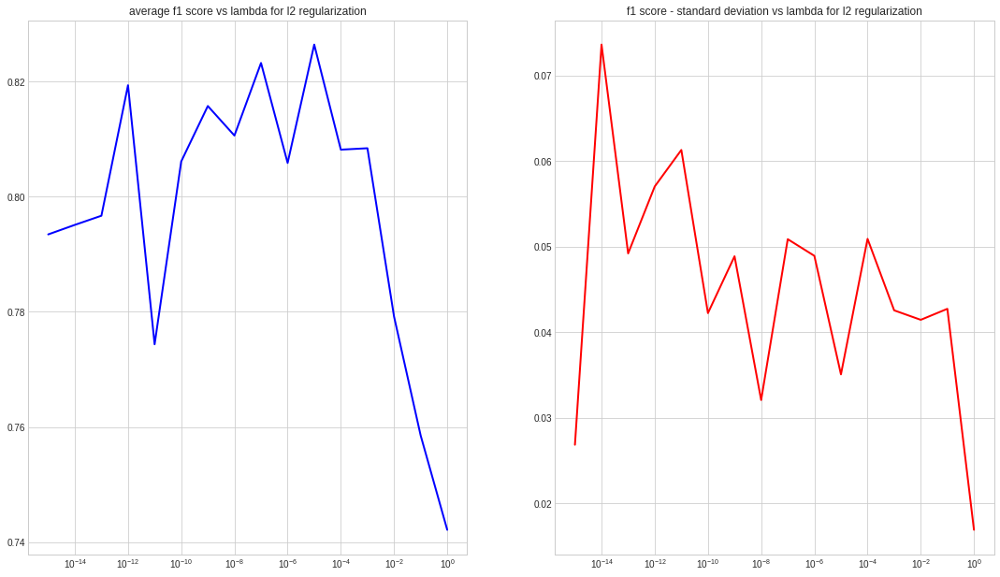

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
fig = plt.figure()
fig.set_size_inches(18.5, 10.5, forward=True)
ax = fig.add_subplot(1, 2, 1)
ax.set_title('average f1 score vs lambda for l2 regularization')
ax2 = fig.add_subplot(1, 2, 2)
ax2.set_title('f1 score - standard deviation vs lambda for l2 regularization')
line, = ax.plot(results_reg_val['lambda'], results_reg_val['f1_score_avg'], color='blue', lw=2)
line, = ax2.plot(results_reg_val['lambda'], results_reg_val['f1_score_std'], color='red', lw=2)
ax.set_xscale('log')
ax2.set_xscale('log')
plt.show


#### 05-02-02) Evaluating the for the best lambda

In [ ]:
results_reg = evaluate_model_reg(X, y, 5, [16, 16, 16, 16, 1], 'adam',  'binary_crossentropy', ['accuracy'], 100, 32,  ['relu','sigmoid'], 1e-5, results_reg)

Average F1 Score for NN with No of Layers:  5, Units: [16, 16, 16, 16, 1], optimizer: adam, loss: binary_crossentropy, metrics: ['accuracy'], lambda: 0.0000 = 0.842
